# Improving beat tracking algorithms with recurrent neural network

## Formulating the problem

Finding the beats in a piece of music is an inherently human task. When listening to a song, by instinct, we can tap our foot or nod our head on the rhythm without having to think too much about it. However, for a computer, deciding when exactly is the right time to tap is a highly non-trivial task.

Many algorithms already exist for this, with varying degrees of success. They usually begin by estimating the *onsets* of the audio sample, i.e. the times at which a note is most likely to begin. Then, they produce a beat track that best fits those onsets (a popular algorithm for this step uses dynamic programming [1]). A good implementation of this strategy is found in the `librosa` package, as we will demonstrate below.

The problem with this approach is that in many music genres, such as jazz, many of the most accentuated onsets are *not* on the beats. This fools the algorithm, which then produces all sorts of undesirable results.

For example, let's see how it does on small excerpt of a classic song by jazz pianist Keith Jarrett (Bye Bye Blackbird).

In [1]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import IPython.display
from PIL import Image
import torch

import beatfinder     # This project
sr = beatfinder.constants.sr
hl = beatfinder.constants.hl

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
totensor = beatfinder.model.ToTensor(device)
print(f'Device: {device}')

Device: cpu


Let's listen to the excerpt:

In [2]:
offset = 9.4
duration = 10
wav, _ = librosa.load('./data/JAZZ/audio/keith-jarrett/bye-bye-blackbird-01.m4a', 
                      offset=offset, duration=duration, sr=sr)
IPython.display.Audio(wav, rate=sr)

To predict where the beats are, `librosa` first estimates where the notes begin (the onsets) and then fits a beat track on those onsets, as shown below:

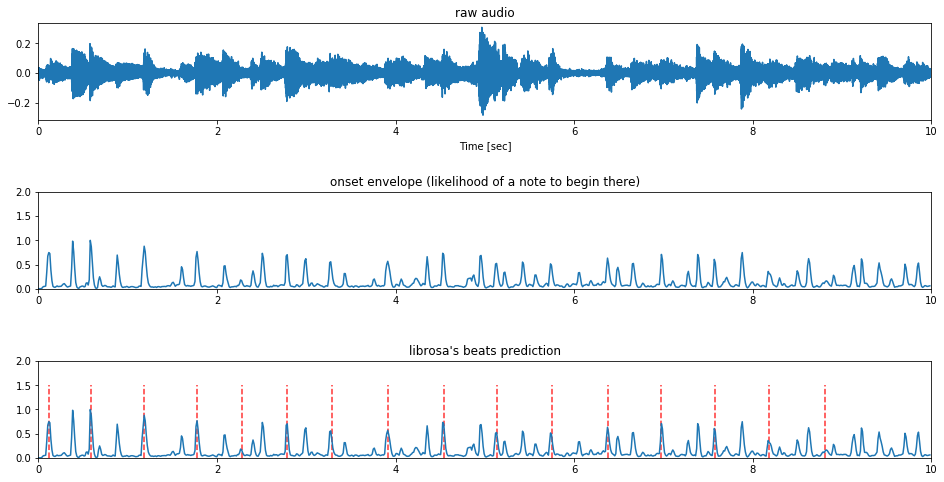

In [4]:
onset_env = librosa.onset.onset_strength(wav, sr=sr, hop_length=hl)[1:]
times = librosa.frames_to_time(np.arange(len(onset_env)), sr, hl)
onset_env -= onset_env.min()
onset_env /= onset_env.max()
bpm, librosa_beats = librosa.beat.beat_track(onset_envelope=onset_env, sr=sr, hop_length=hl, units='time') 

fig, axes = plt.subplots(3, 1)
fig.set_size_inches(16, 8)
fig.subplots_adjust(hspace=0.75)

axes[0].set_title('raw audio')
axes[0].plot(librosa.samples_to_time(np.arange(len(wav)), sr), wav)
axes[0].set_xlim(0, 10)
axes[0].set_xlabel('Time [sec]')

axes[1].set_title('onset envelope (likelihood of a note to begin there)')
axes[1].plot(times, onset_env)
axes[1].set_xlim(0, 10)
axes[1].set_ylim(0, 2)

axes[2].set_title('librosa\'s beats prediction')
axes[2].plot(times, onset_env)
axes[2].vlines(librosa_beats, 0, 1.5, color='r', alpha=0.8, linestyles='--')
axes[2].set_xlim(0, 10)
axes[2].set_ylim(0, 2);

Let's compare to the ground truth:

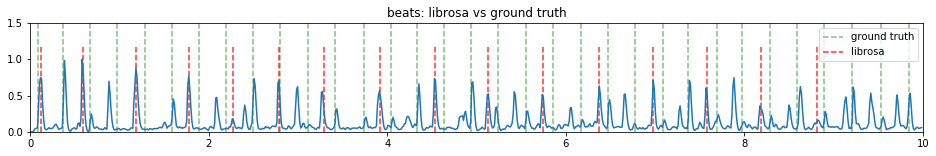

In [5]:
gt = np.loadtxt('./data/JAZZ/beats/bye-bye-blackbird-01.excerpt.beats')
ground_truth_beats = gt[(offset < gt) & (gt < offset + duration)] - offset

plt.figure(figsize=(16, 2))
plt.title('beats: librosa vs ground truth')
plt.plot(times, onset_env)
plt.vlines(ground_truth_beats, 0, 1.5, color='g', alpha=0.5, linestyles='--', label='ground truth')
plt.vlines(librosa_beats, 0, 1.2, color='r', alpha=0.8, linestyles='--', label='librosa')
plt.xlim(0, 10)
plt.ylim(0, 1.5)
plt.legend();

Okay, it got about two beats right (1st and 6th). The problem is that (as is common in jazz) the most emphasised notes are more often not on the beats. Let's listen to the two:

In [6]:
# Librosa's prediction
clicks_lb = librosa.clicks(librosa_beats, sr=sr, hop_length=hl, length=len(wav))
IPython.display.Audio(wav + clicks_lb * 0.3, rate=sr)

In [7]:
# Ground truth
clicks_gt = librosa.clicks(ground_truth_beats, sr=sr, hop_length=hl, length=len(wav))
IPython.display.Audio(wav + clicks_gt * 0.3, rate=sr)

The goal of this project is to explore the use of deep learning to improve this scheme. Rather than computing the beat track on the full onset envelope, we train a neural network to select only the onsets that are most likely to be beats.

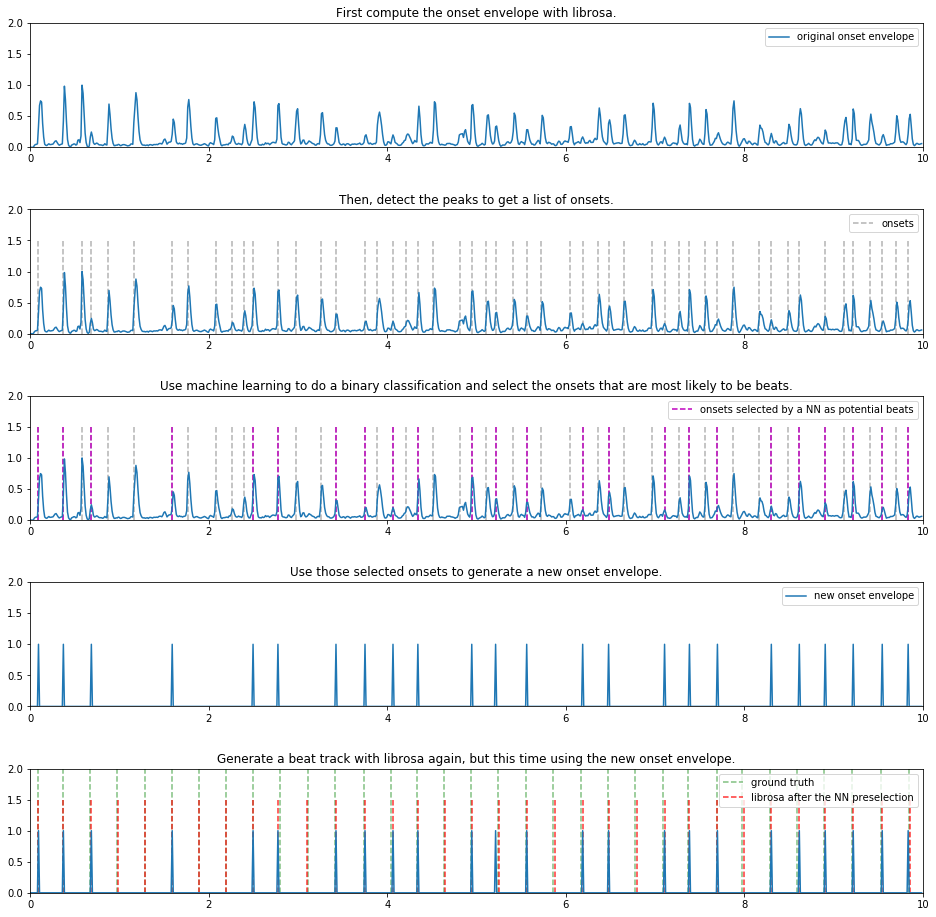

In [8]:
onsets = librosa.onset.onset_detect(onset_envelope=onset_env, sr=sr, hop_length=hl)
onsets_times = librosa.frames_to_time(onsets, sr, hl)
idxs = beatfinder.utils.select_onsets(onsets_times, ground_truth_beats)
beats_predicted, _ = beatfinder.utils.beat_track(onsets[idxs])

fig = plt.figure(figsize=(16, 16))
fig.subplots_adjust(hspace=0.5)

plt.subplot(5, 1, 1)
plt.title('First compute the onset envelope with librosa.')
plt.plot(times, onset_env, label='original onset envelope')
plt.xlim(0, 10)
plt.ylim(0, 2)
plt.legend();

plt.subplot(5, 1, 2)
plt.title('Then, detect the peaks to get a list of onsets.')
plt.plot(times, onset_env)
plt.vlines(onsets_times, 0, 1.5, color='k', alpha=0.3, linestyles='--', label='onsets')
plt.xlim(0, 10)
plt.ylim(0, 2)
plt.legend();

plt.subplot(5, 1, 3)
plt.title('Use machine learning to do a binary classification and select the onsets that are most likely to be beats.')
plt.plot(times, onset_env)
plt.vlines(onsets_times, 0, 1.5, color='k', alpha=0.3, linestyles='--')
plt.vlines(onsets_times[idxs], 0, 1.5, color='m', alpha=1, linestyles='--', label='onsets selected by a NN as potential beats')
plt.xlim(0, 10)
plt.ylim(0, 2)
plt.legend();

plt.subplot(5, 1, 4)
plt.title('Use those selected onsets to generate a new onset envelope.')
new_onset_env = np.zeros_like(onset_env)
new_onset_env[onsets[idxs]] = 1
plt.plot(times, new_onset_env, label='new onset envelope')
plt.xlim(0, 10)
plt.ylim(0, 2)
plt.legend();

plt.subplot(5, 1, 5)
plt.title('Generate a beat track with librosa again, but this time using the new onset envelope.')
plt.plot(times, new_onset_env)
plt.vlines(ground_truth_beats, 0, 2, color='g', alpha=0.5, linestyles='--', label='ground truth')
plt.vlines(beats_predicted, 0, 1.5, color='r', alpha=0.8, linestyles='--', label='librosa after the NN preselection')
plt.xlim(0, 10)
plt.ylim(0, 2)
plt.legend();

This new prediction is much closer to the ground truth. In fact, most humans would not make the difference; this would count as a correct answer.

So we now have formulated our problem:

> *Given a music excerpt and a list of onsets, use machine learning to select which of those onsets are more likely to be beats.*

## How to approach this problem.

### Representation

The first thing is to find a good representation of music. The most natural thing is to use spectrograms:

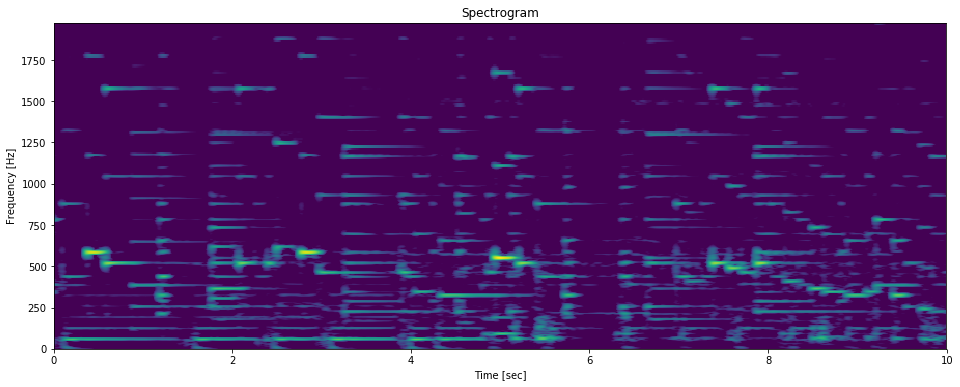

In [21]:
n_mels = 512
fmax = None#2**14
n_fft = 2**12
spec = librosa.feature.melspectrogram(wav, sr, hop_length=hl, n_mels=n_mels, fmax=fmax, n_fft=n_fft)**2
spec = librosa.power_to_db(spec)
#spec = (spec - spec.min()) / (spec.max() - spec.min())
time = librosa.frames_to_time(np.arange(spec.shape[1]), sr, hl)
freq = librosa.mel_frequencies(n_mels=n_mels)[:n_mels//2]
plt.figure(figsize=(16, 6))
plt.pcolormesh(time, freq, spec[:n_mels//2, :])
plt.xlabel('Time [sec]')
plt.ylabel('Frequency [Hz]')
plt.title('Spectrogram');

This more or less corresponds to how humans percieve sounds. We have time on the x-axis, and frequency (pitch) on the y-axis, so that at any given instant of time we know which frequencies are heard. We can see the notes played on the piano by Keith Jarrett at around 500 Hz, as well as Gary Peacock's bass on the bottom.

Since this is an image, we can feed it into a usual 2d convolutional stack. But I didn't get good results with that. Perhaps it has to do with the fact that spotting animal faces in spectrograms is not so useful after all.

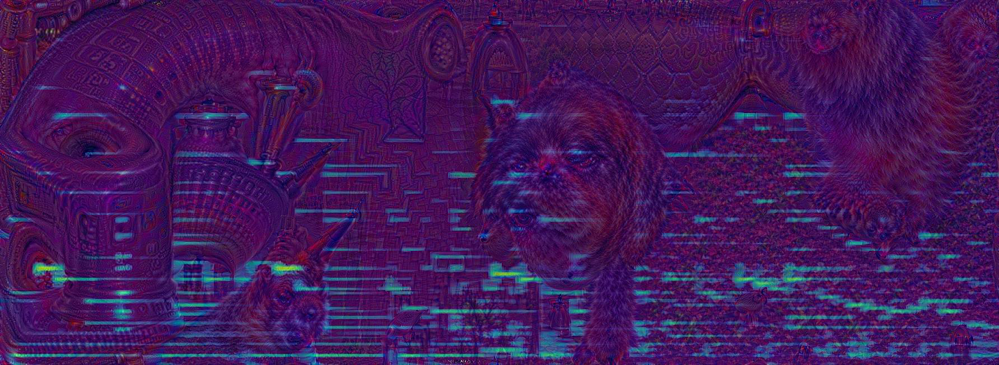

In [11]:
Image.open('./pictures/dream-spec-1.jpeg')

(Image generated with https://github.com/L1aoXingyu/Deep-Dream.)

More seriously, an audio signal is inherently a time series and hence we get better results by treating it that way. So we will view spectrograms as squences of intensity/frequence curves rather than 2d images and use recurrent neural networks. 

In [22]:
fig, ax = plt.subplots()
fig.set_size_inches(16, 4)
ax.axis([0, freq[-1], spec.min(), spec.max()])
ax.set_title('Spectrogram as a time series')
ax.set_xlabel('Frequency [Hz]')
ax.set_ylabel('Intensity [Db]')
line, = ax.plot([], [])
line.set_color('g')

def init():
    line.set_data([], [])
    return line,

def animate(i):
    line.set_data(freq, spec[:n_mels//2, 2 * i])
    return line,

anim = animation.FuncAnimation(fig, 
                               animate, 
                               init_func=init, 
                               frames=spec.shape[1] // 2, 
                               interval=2 * 1000 * hl / sr, 
                               blit=True);
plt.close(fig)
IPython.display.HTML(anim.to_jshtml())

### The model

As mentioned above, we use a recurrent neural network to do a binary classification selecting which onsets are beats. At each call, it receives a spectrogram viewed as a sequence of intensity/frequency curves as above, and outputs a sequence of the probabilities. But we only compute the loss (binary cross entropy) on the elements of the sequence where an onset has been detected (with `librosa`); the target data is saying which of those onsets are close enough (<0.05 second) to a ground truth beat. In other words, each element in the output sequence is the probability of being a beat given that it is an onset. More precisely, our model consists of 3 LSTM cells followed by a fully connected layer with two ouputs. The onsets are also computed with the spectrogram, so the flowchart looks like this:

<img src="./pictures/flowchart.jpg" alt="Drawing" style="width: 600px;"/>

The model has been implemented in PyTorch:

In [2]:
model = beatfinder.model.BeatFinder()
print(model)

BeatFinder(
  (lstm): LSTM(256, 256, num_layers=3, batch_first=True, dropout=0.2, bidirectional=True)
  (hid_to_beat): Linear(in_features=512, out_features=2, bias=True)
  (loss_function): NLLLoss()
)


### Datasets

I used three different datasets to train the model: [BALLROOM](https://github.com/CPJKU/BallroomAnnotations), [GTZAN](http://anasynth.ircam.fr/home/media/GTZAN-rhythm), and [HAINSWORTH](http://www.marsyas.info/tempo/). Once they are downloaded, this package contains python scripts to put them in a common format. Each dataset consists of audio files of short musical excerpt (~30-60 seconds) and text files listing the beats in seconds. 

This kind of data is not trivial to work with. There are several things we want:

* To make minibatches, we want all data samples to be of the same length, although the audio files are of different lengths. 
* We want to be able to easily do data augmentation by slowing and speeding the audio. 
* Computing the spectrograms takes a very long, so we want to precompute and save them.

I implemented a convenient data structure that does all this in the `beatfinder.datasets` module. Each sample in the dataset is an instance of a class called `AudioBeats`. This class doesn't store any data itself, but points to the right files. Its main attributes are:

* `self.audio_file`: The name of an audio file (e.g. `./something.wav`).
* `self.offset`: The starting point in seconds of this sample in the audio file (e.g. `9.4 seconds`).
* `self.duration`: The duration of the sample (e.g. `10 seconds`).
* `self.stretch`: The amount by which to stretch the audio file for data augmentation (e.g. `1` for no stretching, or `2` for twice slower).
* `self.beats_file`: The name of the file containing the beats in seconds.
* `self.spec_file`: Where to save the spectrogram of this sample.
* `self.onsets_file`: Where to save the list of onsets and which of those are selected as beats.

And the main methods are:

* `self.get_data`: Returns the spectrogram, the list of onsets, the list of onsets that are beats, and the list of beats.
* `self.precompute`: Compute the spectrogram, the onsets, which onsets are beats, and save this information in the files `self.spec_file` and `self.onsets_file`.

A dataset for this project is an instance of the `AudioBeatsDataset` class (in the `beatfinder.datasets` module) which is a PyTorch `Dataset` whose items are `AudioBeats` objects.

Such a dataset has a convenient `save` method so that we can recover it later. Let's load one of them:

In [2]:
validset = beatfinder.datasets.load('./data/saved-datasets/tmp/validset.ab')
print(f'Dataset size: {len(validset)}')

Dataset size: 420


Take a random sample:

In [3]:
audiobeats = validset[np.random.randint(len(validset))]

In the `beatfinder.display` module, there are some useful methods to see the data pointed by such an `AudioBeats` object:

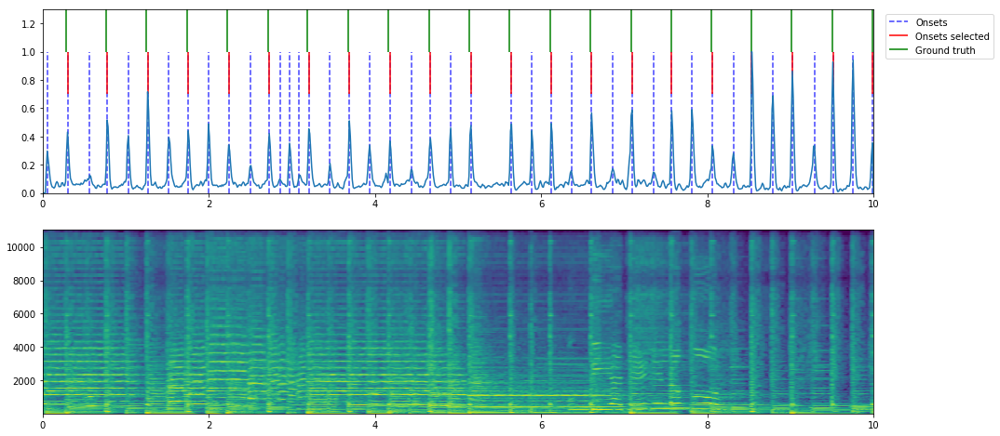

In [4]:
beatfinder.display.showdata(audiobeats)

On the first figure, we see the onsets, the onsets that are beats, and the ground truth beats. The second figure is the spectrogram.

### Example of prediction

Let's see how our pretrained model (which has not been trained on this dataset) does on the above sample.

In [5]:
totensor = beatfinder.model.ToTensor(device)
model = beatfinder.model.BeatFinder()
model.load_state_dict(torch.load('./data/pretrained-models/model_11.pt', map_location=device))
model.to(device)
model.eval()
model.freeze()

In [6]:
ground_truth_beats = audiobeats.get_beats()
onsets_selected, predicted_beats, bpm = beatfinder.utils.predict_beats(model, audiobeats, totensor)

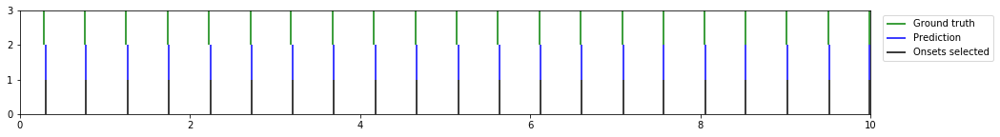

In [7]:
beatfinder.display.showprediction(ground_truth_beats, predicted_beats, onsets_selected)

That seems like close enough. A common measure is to evaluate the F-score, where two beats are considered the same if they are less than 0.07 seconds from each other:

In [8]:
beatfinder.utils.F_measure(ground_truth_beats, predicted_beats)

1.0

Note that we got a perfect score in the end, even if the model didn't get all predictions right. Some of the onsets selected as beats (the black bars above) are not beats, but we got enough of them right so that librosa's beat tracking algorithm can take it from there and get the right result. That's the power of this method: we use deep learning to give a standard algorithm just a little push in the right direction so that it gets better results. Hence, the deep learning model itself doesn't have to be perfect to get a perfect result.

Let's compute the F-measure that we get on the whole validation set with this model and compare it with librosa alone.

In [9]:
tp, fn, fp = beatfinder.utils.evaluate_dataset(validset, model, totensor, verbose=True)

  1/420 | tp:   0 | fn:  16 | fp:  15
  2/420 | tp:   8 | fn:   7 | fp:   9
  3/420 | tp:   6 | fn:   9 | fp:  13
  4/420 | tp:   0 | fn:   0 | fp:   4
  5/420 | tp:   0 | fn:   0 | fp:   1
  6/420 | tp:  13 | fn:   0 | fp:   1
  7/420 | tp:  24 | fn:   0 | fp:   3
  8/420 | tp:  27 | fn:   0 | fp:   0
  9/420 | tp:  24 | fn:   3 | fp:   3
 10/420 | tp:  14 | fn:  15 | fp:   3
 11/420 | tp:  33 | fn:   1 | fp:   0
 12/420 | tp:  14 | fn:  20 | fp:  11
 13/420 | tp:  21 | fn:   0 | fp:   0
 14/420 | tp:  21 | fn:   0 | fp:   0
 15/420 | tp:  20 | fn:   0 | fp:   0
 16/420 | tp:  18 | fn:   4 | fp:   3
 17/420 | tp:  20 | fn:   1 | fp:   0
 18/420 | tp:  19 | fn:   2 | fp:   1
 19/420 | tp:  11 | fn:  19 | fp:   0
 20/420 | tp:  23 | fn:   7 | fp:   3
 21/420 | tp:  29 | fn:   1 | fp:   0
 22/420 | tp:  12 | fn:   1 | fp:   2
 23/420 | tp:  11 | fn:   3 | fp:   3
 24/420 | tp:  14 | fn:   0 | fp:   0
 25/420 | tp:   8 | fn:  13 | fp:  13
 26/420 | tp:  20 | fn:   1 | fp:   0
 27/420 | tp

KeyboardInterrupt: 

# Pictures

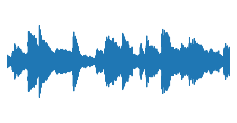

In [13]:
fig = plt.figure(figsize=(4, 2))
ax = fig.add_subplot(111)
librosa.display.waveplot(wav)
ax.set_xlim(0, 4)
ax.set_ylim(-0.3, 0.3)
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)
ax.set_frame_on(False)
plt.savefig('./pictures/raw_audio.jpg', bbox_inches='tight', pad_inches=0)

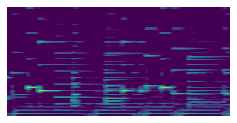

In [15]:
n_mels = 256
fmax = 2**14
n_fft = 2**12
spec = librosa.feature.melspectrogram(wav, sr, hop_length=hl, n_mels=n_mels, fmax=fmax, n_fft=n_fft)**2
spec = librosa.power_to_db(spec)
time = librosa.frames_to_time(np.arange(spec.shape[1]), sr, hl)
freq = librosa.mel_frequencies(n_mels=n_mels)[:n_mels//2]
fig = plt.figure(figsize=(4,2))
ax = fig.add_subplot(111)
ax.pcolormesh(time, freq, spec[:n_mels//2, :])
ax.set_xlim(0, 4)
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)
ax.set_frame_on(False)
plt.savefig('./pictures/spec.jpg', bbox_inches='tight', pad_inches=0)

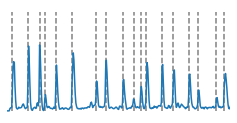

In [16]:
fig = plt.figure(figsize=(4, 2))
ax = fig.add_subplot(111)
plt.plot(times, onset_env)
plt.vlines(onsets_times, 0, 1.5, color='k', alpha=0.5, linestyles='--', label='onsets')
ax.set_xlim(0, 4)
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)
ax.set_frame_on(False)
plt.savefig('./pictures/onsets.jpg', bbox_inches='tight', pad_inches=0)

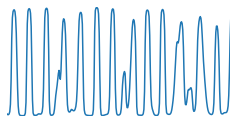

In [65]:
fig = plt.figure(figsize=(4, 2))
ax = fig.add_subplot(111)
plt.plot(times, probs[:-1])
ax.set_xlim(0, 4)
ax.set_ylim(0, 1)
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)
ax.set_frame_on(False)
plt.savefig('./pictures/pred.jpg', bbox_inches='tight', pad_inches=0)

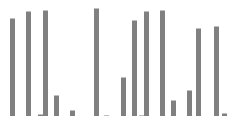

In [85]:
fig = plt.figure(figsize=(4, 2))
ax = fig.add_subplot(111)
plt.vlines(onsets_times, 0, probs[onsets], color='Gray', linewidths=5)
ax.set_xlim(0, 4)
ax.set_ylim(0, 1)
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)
ax.set_frame_on(False)
plt.savefig('./pictures/beats-probs.jpg', bbox_inches='tight', pad_inches=0)

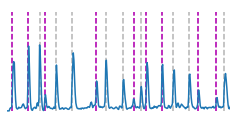

In [86]:
fig = plt.figure(figsize=(4, 2))
ax = fig.add_subplot(111)
plt.plot(times, onset_env)
plt.vlines(onsets_times, 0, 1.5, color='k', alpha=0.3, linestyles='--')
plt.vlines(onsets_times[probs[onsets] > 0.5], 0, 1.5, color='m', alpha=1, linestyles='--')
ax.set_xlim(0, 4)
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)
ax.set_frame_on(False)
plt.savefig('./pictures/onsets-selected.jpg', bbox_inches='tight', pad_inches=0)

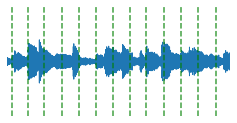

In [18]:
fig = plt.figure(figsize=(4, 2))
ax = fig.add_subplot(111)
librosa.display.waveplot(wav)
plt.vlines(ground_truth_beats, -0.5, 0.5, color='g', alpha=0.75, linestyles='--', label='ground truth')
ax.set_xlim(0, 4)
ax.set_ylim(-0.5, 0.5)
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)
ax.set_frame_on(False)
plt.savefig('./pictures/beats.jpg', bbox_inches='tight', pad_inches=0)

In [19]:
model = beatfinder.model.BeatFinder()
model.load_state_dict(torch.load('./data/pretrained-models/model_11.pt', map_location=device))
model.to(device)
model.eval()
model.freeze()

In [20]:
audiobeats = beatfinder.datasets.AudioBeats(
    audio_file='./data/JAZZ/audio/keith-jarrett/bye-bye-blackbird-01.m4a',
    beats_file='./data/JAZZ/beats/bye-bye-blackbird-01.excerpt.beats',
    spec_file='./data/JAZZ/tmp/demo-spec.npy',
    onsets_file='./data/JAZZ/tmp/demo-onsets.csv',
    stretch=1,
    offset=offset,
    duration=duration,
    length=librosa.time_to_samples(duration, sr),
    song_duration=librosa.get_duration(filename='./data/JAZZ/audio/keith-jarrett/bye-bye-blackbird-01.m4a'),
    name='demo'
)

In [21]:
audiobeats.precompute()

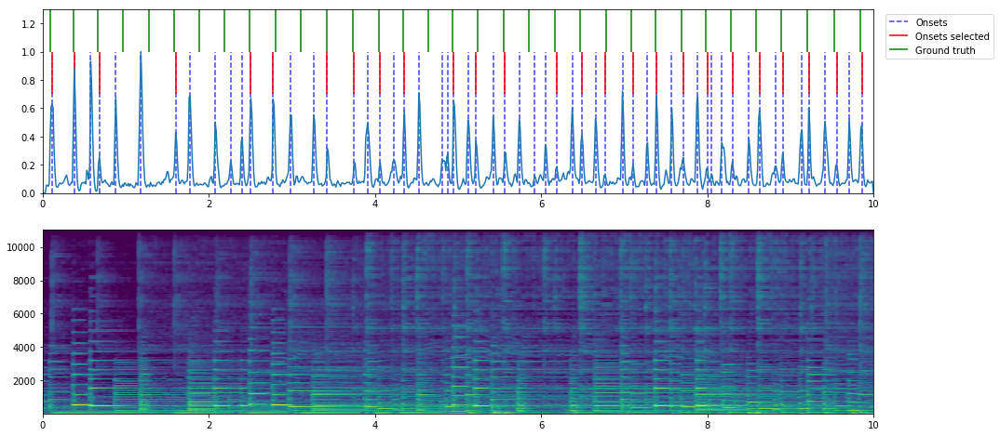

In [22]:
beatfinder.display.showdata(audiobeats)

In [23]:
from torch.utils.data import DataLoader

In [57]:
model.freeze()
model.eval()
totensor = beatfinder.model.ToTensor(device)
dataset = beatfinder.datasets.AudioBeatsDataset([audiobeats], totensor)
dataloader = DataLoader(dataset)
sample = iter(dataloader).next()
probs = torch.exp(model(sample[0]).squeeze(0)[:, 1]).cpu().numpy()

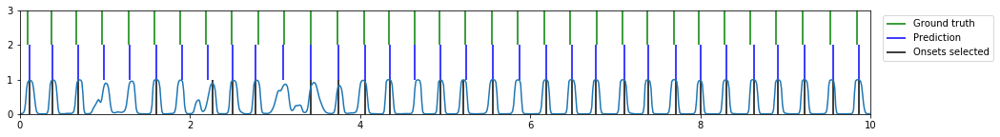

In [58]:
onsets_selected, beats_pred, bpm = beatfinder.utils.predict_beats(model, audiobeats, totensor)
beats = audiobeats.get_beats()
beatfinder.display.showprediction(beats, beats_pred, onsets_selected)
plt.plot(times, probs[:-1])

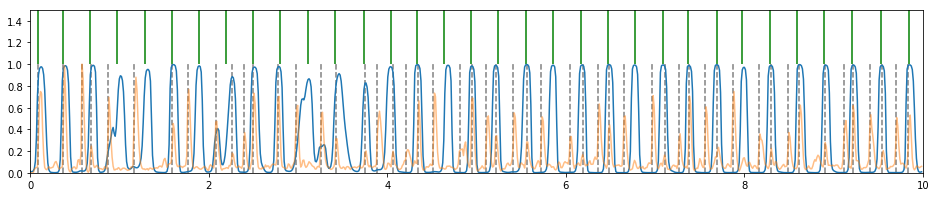

In [59]:
plt.figure(figsize=(16, 3))
plt.plot(times, probs[:-1])
plt.plot(times, onset_env, alpha=0.5)
plt.vlines(onsets_times, 0, 1, color='k', alpha=0.5, linestyles='--')
plt.vlines(beats, 1, 1.5, color='g')
plt.ylim(0, 1.5)
plt.xlim(0, 10);

In [55]:
model.unfreeze()
model.train()

BeatFinder(
  (lstm): LSTM(256, 256, num_layers=3, batch_first=True, dropout=0.2, bidirectional=True)
  (hid_to_beat): Linear(in_features=512, out_features=2, bias=True)
  (loss_function): NLLLoss()
)

In [56]:
model.fit(dataset, dataset, epochs=5);

| 1 | L: 0.393 0.250 | F: 0.863 0.943 | A: 0.879 0.948 | 5.50 s/b | 0:00:05 | ETA: 0:00:22 |
| 2 | L: 0.252 0.126 | F: 0.923 0.963 | A: 0.931 0.966 | 5.39 s/b | 0:00:05 | ETA: 0:00:16 |
| 3 | L: 0.129 0.104 | F: 0.981 0.963 | A: 0.983 0.966 | 5.34 s/b | 0:00:05 | ETA: 0:00:10 |
| 4 | L: 0.116 0.100 | F: 0.929 0.981 | A: 0.931 0.983 | 5.54 s/b | 0:00:05 | ETA: 0:00:05 |
| 5 | L: 0.105 0.079 | F: 0.945 0.981 | A: 0.948 0.983 | 5.53 s/b | 0:00:05 | ETA: 0:00:00 |
